In [123]:
import pandas as pd
import numpy as np
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
import seaborn as sns


In [21]:
Train = pd.read_csv('F:/Term 7/Intelligent Systems/titanic-train.csv')

In [22]:
Train

,Survived,Pclass,Embarked,Sex,Age,SibSp,Parch,Fare
0,0,3,S,male,22.0,1,0,7.2500
1,1,1,C,female,38.0,1,0,71.2833
2,1,3,S,female,26.0,0,0,7.9250
3,1,1,S,female,35.0,1,0,53.1000
4,0,3,S,male,35.0,0,0,8.0500
...,...,...,...,...,...,...,...,...
886,0,2,S,male,27.0,0,0,13.0000
887,1,1,S,female,19.0,0,0,30.0000
888,0,3,S,female,NaN,1,2,23.4500
889,1,1,C,male,26.0,0,0,30.0000


In [23]:
encoder = preprocessing.LabelEncoder()
def prepro(data, isTest):
    try:
        # Remove useless columns
        data = data.drop(['PassengerId', 'Name', 'Ticket', 'Cabin'], axis=1)
        if isTest:
            data = data.drop(['Survived'], axis = 1)
        # Filling empty numerical values with median
        data['Age'] = data['Age'].fillna(data['Age'].median())
        data['Fare'] = data['Fare'].fillna(data['Fare'].median())
      
    except KeyError as e:
        print('Invalid preprocess')
        print(e)
    # Returning preprocessed data
    return data
def convert_sex_to_num(s):
    if s=='male':
        return 0
    elif s=='female':
        return 1
    else:
        return s
def convert_Embarked_to_num(s):
    if s=='S':
        return 0
    elif s=='C':
        return 1
    elif s=='Q':
        return 2
    else:
        return s
Train.Sex = Train.Sex.map(convert_sex_to_num)
Train.Embarked = Train.Embarked.map(convert_Embarked_to_num)
Train.head()

,Survived,Pclass,Embarked,Sex,Age,SibSp,Parch,Fare
0,0,3,0.0,0,22.0,1,0,7.2500
1,1,1,1.0,1,38.0,1,0,71.2833
2,1,3,0.0,1,26.0,0,0,7.9250
3,1,1,0.0,1,35.0,1,0,53.1000
4,0,3,0.0,0,35.0,0,0,8.0500


In [24]:
train = prepro(Train, True)
train.head()

Invalid preprocess
"['PassengerId', 'Name', 'Ticket', 'Cabin'] not found in axis"


,Survived,Pclass,Embarked,Sex,Age,SibSp,Parch,Fare
0,0,3,0.0,0,22.0,1,0,7.2500
1,1,1,1.0,1,38.0,1,0,71.2833
2,1,3,0.0,1,26.0,0,0,7.9250
3,1,1,0.0,1,35.0,1,0,53.1000
4,0,3,0.0,0,35.0,0,0,8.0500


In [25]:
categorical_cols = [col for col in train.columns if
                   train[col].nunique() < 10 and
                   train[col].dtype == 'object'
                   ]
                   
# Extracting numerical columns
numerical_cols = [col for col in train.columns if train[col].dtype in ['int64', 'float64']]

print(categorical_cols)
print(numerical_cols)

[]
['Survived', 'Pclass', 'Embarked', 'Sex', 'Age', 'SibSp', 'Parch', 'Fare']


In [26]:


train.dropna()



,Survived,Pclass,Embarked,Sex,Age,SibSp,Parch,Fare
0,0,3,0.0,0,22.0,1,0,7.2500
1,1,1,1.0,1,38.0,1,0,71.2833
2,1,3,0.0,1,26.0,0,0,7.9250
3,1,1,0.0,1,35.0,1,0,53.1000
4,0,3,0.0,0,35.0,0,0,8.0500
...,...,...,...,...,...,...,...,...
885,0,3,2.0,1,39.0,0,5,29.1250
886,0,2,0.0,0,27.0,0,0,13.0000
887,1,1,0.0,1,19.0,0,0,30.0000
889,1,1,1.0,0,26.0,0,0,30.0000


In [112]:
def divide_data(x_data, fkey, fval):
    x_right = pd.DataFrame([], columns=x_data.columns)
    x_left = pd.DataFrame([], columns=x_data.columns)
    
    
    for ix in range(x_data.shape[0]):
        
        val = x_data[fkey].loc[ix]
     
        if val > fval:
            x_right = x_right.append(x_data.loc[ix])
        else:
            x_left = x_left.append(x_data.loc[ix])

    return x_left, x_right


def entropy(col):
    p = []
    p.append(col.mean())
    p.append(1-p[0])
    
    ent = 0.0
    for px in p:
        ent += (-1.0 * px * np.log2(px))
    return ent

def information_gain(xdata, fkey, fval):
    left, right = divide_data(xdata, fkey, fval)
    
    if left.shape[0] == 0 or right.shape[0] == 0:
        return -10000
    
    return 2*entropy(xdata.Survived) - (entropy(left.Survived) + entropy(right.Survived))


class DecisionTree:
    def __init__(self, depth=0, max_depth=3):
        self.left = None
        self.right = None
        self.fkey = None
        self.fval = None
        self.max_depth = max_depth
        self.depth = depth
        self.target = None
    
    def train(self, X_train):
        print(self.depth, '-'*10)
        features = ['Pclass', 'Sex', 'Age', 'SibSp', 'Parch', 'Fare']
        gains = []
        for fx in features:
            gains.append(information_gain(X_train, fx, X_train[fx].mean()))
        
        self.fkey = features[np.argmax(gains)]
        self.fval = X_train[self.fkey].mean()
        
        data_left, data_right = divide_data(X_train, self.fkey, self.fval)
        data_left = data_left.reset_index(drop=True)
        data_right = data_right.reset_index(drop=True)
        
        if data_left.shape[0] == 0 or data_right.shape[0] == 0:
            if X_train.Survived.mean() >= 0.5:
                self.target = 'Survived'
            else:
                self.target = 'Dead'
            return
        
        if self.depth >= self.max_depth:
            if X_train.Survived.mean() >= 0.5:
                self.target = 'Survived'
            else:
                self.target = 'Dead'
            return
        
        self.right = DecisionTree(depth=self.depth+1, max_depth=self.max_depth)
        self.right.train(data_right)

        self.left = DecisionTree(depth=self.depth+1, max_depth=self.max_depth)
        self.left.train(data_left)
        
        if X_train.Survived.mean() >= 0.5:
            self.target = 'Survived'
        else:
            self.target = 'Dead'
        
        return
    
    def predict(self, test):
        if test[self.fkey] > self.fval:

            if self.right is None:
                return self.target
            return self.right.predict(test)
        else:

            if self.left is None:
                return self.target
            return self.left.predict(test)
   
        
        


In [67]:
split = int(0.8 * trainSet.shape[0])

training_data = trainSet[:split]
testing_data = trainSet[split:]

In [68]:
training_data

,Survived,Pclass,Embarked,Sex,Age,SibSp,Parch,Fare
0,0,1,0.0,0,45.5,0,0,28.5000
1,0,2,0.0,0,23.0,0,0,13.0000
2,0,3,0.0,0,32.0,0,0,7.9250
3,0,3,0.0,0,26.0,1,0,7.8542
4,0,3,0.0,1,6.0,4,2,31.2750
...,...,...,...,...,...,...,...,...
564,0,2,0.0,0,42.0,1,0,27.0000
565,0,3,0.0,0,35.0,0,0,8.0500
566,0,3,0.0,1,2.0,3,2,27.9000
567,1,3,0.0,1,31.0,0,0,8.6833


### depth = 3

In [133]:
dt3 = DecisionTree(max_depth=3)
dt3.train(training_data)

0 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

1 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.app

2 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

2 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.a

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.app

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.app

1 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

2 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

2 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.a

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.a

In [134]:
pred = []

for ix in testing_data.index[:143]:
    pred.append(dt3.predict(testing_data.loc[ix]))


y_test = list(testing_data.iloc[:,0])

acc0.8251748251748252
depth 3


<AxesSubplot:>

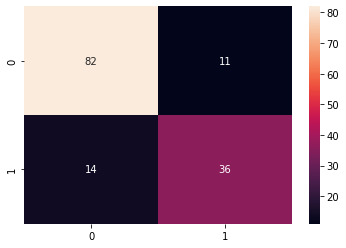

In [135]:
for i in range(len(pred)):
    if(pred[i]=='Survived'):
        pred[i] = 1
    else:
        pred[i] = 0

count = 0    
for i in range(len(pred)):
    if(pred[i]==y_test[i]):
        count += 1
acc = count/143
print('acc'+str(acc))


cm_3 = confusion_matrix(y_test, pred)
print ("depth 3")
sns.heatmap(cm_3, annot=True)  

### depth = 10

In [142]:
dt10 = DecisionTree(max_depth=10)
dt10.train(training_data)

0 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

1 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

2 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: invalid value encountered in double_scalars
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be remo

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: invalid value encountered in double_scalars
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be remo

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: invalid value encountered in double_scalars
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be remo

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

2 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: invalid value encountered in double_scalars
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be remo

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: invalid value encountered in double_scalars
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be remo

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.a

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.app

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: invalid value encountered in double_scalars
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be remo

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.a

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

1 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.app

2 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.app

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: invalid value encountered in double_scalars
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be remo

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

2 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.a

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: invalid value encountered in double_scalars
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be remove

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.a

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.app

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.app

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.a

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: invalid value encountered in double_scalars
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be remo

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.a

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

8 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

9 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

10 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

0.8181818181818182
depth 10


<AxesSubplot:>

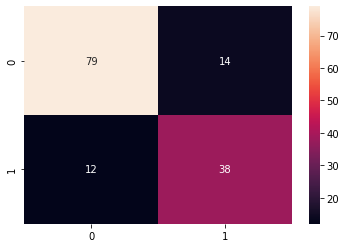

In [144]:
pred10 = []

for ix in testing_data.index[:143]:
    pred10.append(dt10.predict(testing_data.loc[ix]))


y_test = list(testing_data.iloc[:,0])
for i in range(len(pred10)):
    if(pred10[i]=='Survived'):
        pred10[i] = 1
    else:
        pred10[i] = 0

count = 0    
for i in range(len(pred10)):
    if(pred10[i]==y_test[i]):
        count += 1
acc10 = count/143
print(acc10)

cm_10 = confusion_matrix(y_test, pred10)
print ("depth 10")
sns.heatmap(cm_10, annot=True)    

### depth = 7

In [138]:
dt7 = DecisionTree(max_depth=7)
dt7.train(training_data)




    

0 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

1 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.a

2 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

2 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.a

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.a

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.app

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.app

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.a

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

1 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.app

2 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.a

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.a

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

2 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.a

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.app

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\39169232

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

3 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: invalid value encountered in double_scalars
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be remo

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.a

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.appen

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.app

4 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.a

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

5 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.a

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: divide by zero encountered in log2
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:25: RuntimeWarning: invalid value encountered in double_scalars
  ent += (-1.0 * px * np.log2(px))
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be remove

6 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.a

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_left = x_left.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.appen

7 ----------


C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right.append(x_data.loc[ix])
C:\Users\Niloufar Faridani\AppData\Local\Temp\ipykernel_11572\3916923270.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  x_right = x_right

0.8391608391608392
depth 7


<AxesSubplot:>

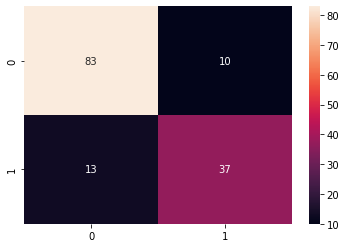

In [141]:
pred7 = []
for ix in testing_data.index[:143]:
    pred7.append(dt7.predict(testing_data.loc[ix]))


y_test = list(testing_data.iloc[:,0])
i = 0 
for i in range(len(pred7)):
    if(pred7[i]=='Survived'):
        pred7[i] = 1
    else:
        pred7[i] = 0

count = 0    
for i in range(len(pred7)):
    if(pred7[i]==y_test[i]):
        count += 1
acc7 = count/143
print(acc7)
cm_7 = confusion_matrix(y_test, pred7)
print ("depth 7")
sns.heatmap(cm_7, annot=True) 